# Classifier for SST-5

We will train a ratings predictor using the sentences embeddings as input.

## Import Libraries

In [15]:
import torch
import torch.nn as nn
from torch.utils.data import Dataset
from torchvision.transforms import v2
from torch.utils.tensorboard import SummaryWriter

import pandas as pd
import numpy as np
import seaborn as sns

from datetime import datetime
import os

In [2]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [ ]:
best_accuracy = 0.5694822888283378

## Loading SST-5 Vectors

In [6]:
class SST5Datasets(Dataset):
  def __init__(self, model_name, df_type):
    self.df = pd.read_parquet(f"SST-5_{df_type}.parquet").rename(
      columns={'truth': 'rating', 'vectors': 'vector'}
    )

    data_path = os.path.join("embeddings", f"{model_name}_{df_type}.npy")
    self.X = torch.from_numpy(np.load(data_path)).to(device)
    self.y = torch.tensor((self.df['rating'] - 1).values, dtype=torch.int64).to(device)

  def __len__(self):
    return len(self.df)

  def __getitem__(self, idx):
    return self.X[idx, :], self.y[idx]

## Neural Network

In [7]:
def create_model(hidden_layer_width = [64], dropout_rates = [0.0]):
  layers = []

  for width, p in zip(hidden_layer_width, dropout_rates, strict=True):
    layers.append(nn.Dropout(p))
    layers.append(nn.LazyLinear(width))
    layers.append(nn.ReLU())

  layers.append(nn.LazyLinear(5))

  return nn.Sequential(*layers).to(device)


In [8]:
def train_one_epoch(
    model, optimizer, loss_fn, trainloader, mixup,
    epoch_index, tb_writer, mixup_transformer
  ):
  running_loss = 0.0
  avg_loss = 0.0

  running_accuracy = 0.0
  avg_accuracy = 0.0

  avg_window_size = len(trainloader) // 5

  for i, data in enumerate(trainloader):
    batch, labels = data

    optimizer.zero_grad()
    if mixup:
      batch_size = batch.shape[0]
      batch, labels = mixup_transformer(batch.unsqueeze(-1).unsqueeze(-1), labels)
      outputs = model(batch.view(batch_size, -1))
    else:
      outputs = model(batch)

    loss = loss_fn(outputs, labels)
    loss.backward()
    optimizer.step()

    # Gather data and report
    running_loss += loss.item()

    _, predicted = torch.max(outputs, dim=1)
    running_accuracy += int((predicted == labels).sum()) / labels.shape[0]

    if i % avg_window_size == avg_window_size - 1:
      avg_loss = running_loss / avg_window_size # loss per batch
      avg_accuracy = running_accuracy / avg_window_size

      # print(f'  batch {i + 1:3d} loss: {avg_loss:.4f} accuracy: {avg_accuracy:.4f}')

      tb_x = epoch_index * len(trainloader) + i + 1
      tb_writer.add_scalar('Loss/train', avg_loss, tb_x)

      running_loss = 0.0
      running_accuracy = 0.0

  return avg_loss, avg_accuracy

In [9]:
def train_model(
    embedding_name, model, n_epochs = 20, mixup = False,
    lr = 1e-3, momentum=0.9, batch_size=32,
  ):

  # Load the embedded vectors
  trainset = SST5Datasets(embedding_name, "train")
  trainloader = torch.utils.data.DataLoader(
    trainset, batch_size=batch_size, shuffle=True
  )

  validationset = SST5Datasets(embedding_name, "validation")
  validationloader = torch.utils.data.DataLoader(
    validationset, batch_size=batch_size, shuffle=True
  )

  # Create optimizer and loss function
  optimizer = torch.optim.SGD(model.parameters(), lr=lr, momentum=momentum)

  if mixup:
    mixup_transformer = v2.MixUp(num_classes=5)
    loss_fn = nn.MSELoss()
  else:
    mixup_transformer = None
    loss_fn = nn.CrossEntropyLoss()

  # Train the model and write results to Tensor
  timestamp = datetime.now().strftime('%Y%m%d_%H%M%S')
  runs_path = os.path.join("runs", f"{embedding_name}_{timestamp}")
  writer = SummaryWriter(runs_path)

  for epoch in range(n_epochs):
    # title = f" EPOCH {epoch + 1} "
    # print(f"{title:=^65}")

    model.train(True)
    avg_loss, avg_accuracy = train_one_epoch(
      model, optimizer, loss_fn, trainloader, mixup,
      epoch, writer, mixup_transformer
    )

    running_vloss = 0.0
    corrects = 0
    model.eval()

    with torch.no_grad():
      for i, vdata in enumerate(validationloader):
        vbatch, vlabels = vdata
        voutputs = model(vbatch)
        vloss = loss_fn(voutputs, vlabels)
        running_vloss += vloss

        _, vpredicted = torch.max(voutputs, dim=1)
        corrects += int((vpredicted == vlabels).sum())

    avg_vloss = running_vloss / (i + 1)
    vaccuracy = corrects / len(validationset)
    print(f'EPOCH {epoch + 1} LOSS train {avg_loss:.4f} valid {avg_vloss:.4f} ACCURACY train {avg_accuracy:.4f} valid {vaccuracy:.4f}')

    # Log the running loss averaged per batch
    # for both training and validation
    writer.add_scalars(
      'Training vs. Validation Loss',
      { 'Training' : avg_loss, 'Validation' : avg_vloss },
      epoch
    )
    writer.add_scalars(
      'Training vs. Validation Accuracy',
      { 'Training' : avg_accuracy, 'Validation' : vaccuracy },
      epoch
    )
    writer.flush()

    # Track best performance, and save the model's state
    global best_accuracy
    if vaccuracy > best_accuracy:
      best_accuracy = vaccuracy
      model_path = os.path.join("models", "classifiers", f"{embedding_name}_{timestamp}_{epoch}")
      torch.save(model.state_dict(), model_path)

  writer.add_graph(model, vbatch)
  writer.close()


In [ ]:
model = create_model(dropout_rates=[0.5])
train_model("stella_en_1.5B_v5", model, lr=1e-2, momentum=0.4, n_epochs=20)

In [ ]:
model = create_model(dropout_rates=[0.7])
train_model("gte-Qwen2-1.5B-instruct", model)

In [ ]:
model = create_model(dropout_rates = [0.5])
train_model("gte-Qwen2-7B-instruct", model, n_epochs=100, momentum=0.2, lr=1e-2)

## Fine-tuned Embeddings

In [ ]:
model = create_model(dropout_rates = [0.4])
train_model("stella_en_1.5B_v5_20240814_215640", model, lr=1e-2, momentum=0.2, n_epochs=30)

In [ ]:
model = create_model(dropout_rates = [0.5])
train_model("stella_en_1.5B_v5_20240814_224601", model, lr=1e-2, momentum=0.9, n_epochs=100)

In [ ]:
for dropout in np.linspace(0.2, 0.8, 5):
  for lr in np.logspace(-4, -3, 2):
    for momentum in np.linspace(0.2, 0.8, 5):
      print(f"PARAMETERS DR {dropout:.4f} LR {lr:.6f} M {momentum:.4f}".center(75, "="))
      model = create_model(dropout_rates = [dropout])
      train_model("stella_en_1.5B_v5_20240820_233548", model, lr=lr, momentum=momentum, n_epochs=30)

In [ ]:
for dropout in np.linspace(0.2, 0.8, 4):
  for layer_width in [16, 32, 64, 128]:
    for momentum in np.linspace(0.2, 0.8, 4):
      model = create_model(hidden_layer_width = [layer_width], dropout_rates = [dropout])
      print(f"PARAMETERS DR {dropout:.4f} L1 {layer_width:3d} M {momentum:.4f}".center(75, "="))
      train_model("stella_en_1.5B_v5_20240820_233548", model, lr=1e-3, momentum=momentum, n_epochs=30)

In [ ]:
for dropout in np.linspace(0.2, 0.8, 3):
  for layer_width in [16, 32, 64, 128]:
    for momentum in np.linspace(0.2, 0.8, 3):
      model = create_model(hidden_layer_width = [layer_width], dropout_rates = [dropout])
      print(f"PARAMETERS DR {dropout:.4f} L1 {layer_width:3d} M {momentum:.4f}".center(75, "="))
      train_model("stella_en_1.5B_v5_20240821_204416", model, momentum=momentum, n_epochs=30)

In [ ]:
model = create_model(hidden_layer_width = [128], dropout_rates = [0.5])
train_model("stella_en_1.5B_v5_20240821_204416", model, momentum=0.2, n_epochs=100)

In [ ]:
for dropout in np.linspace(0.2, 0.8, 3):
  for layer_width in [16, 32, 64, 128]:
    for momentum in np.linspace(0.2, 0.8, 3):
      model = create_model(hidden_layer_width = [layer_width], dropout_rates = [dropout])
      print(f"PARAMETERS DR {dropout:.4f} L1 {layer_width:3d} M {momentum:.4f}".center(75, "="))
      train_model("stella_en_1.5B_v5_20240821_211259", model, momentum=momentum, n_epochs=30)

## Tensorboard

In [23]:
%load_ext tensorboard

In [ ]:
%tensorboard --logdir runs

## Evaluate Best Model on Test Data

In [17]:
def load_model(model_file):
  model_file = os.path.join("models", "classifiers", model_file)

  state_dict = torch.load(model_file, map_location=device)

  # Gets layer widths from bias vectors shapes (output layer is taken out)
  widths = [len(item) for key, item in state_dict.items() if key.split(".")[1] == "bias"]
  widths = widths[:-1]

  model = create_model(widths, [0.0] * len(widths))
  model.load_state_dict(state_dict)

  return model

In [20]:
def show_metrics(
    model_file, data_type = "test", batch_size = 32
  ):
  model_name = "_".join(model_file.split("_")[:-3])

  testset = SST5Datasets(model_name, data_type)
  testloader = torch.utils.data.DataLoader(
    testset, batch_size=batch_size, shuffle=True
  )

  model = load_model(model_file + ".zip")

  confusion_matrix = np.zeros((5,5))
  model.eval()

  with torch.no_grad():
    for i, data in enumerate(testloader):
      batch, labels = data
      outputs = model(batch)

      _, predicted = torch.max(outputs, dim=1)

      for label, pred in zip(labels, predicted):
        confusion_matrix[pred, label] += 1

  accuracy = sum(confusion_matrix[i, i] for i in range(5)) / len(testset)
  confusion_matrix /= confusion_matrix.sum(axis=1, keepdims=True)

  print()
  print(f"Accuracy on {data_type}: \t{accuracy:.6f}")
  ax = sns.heatmap(
      confusion_matrix, annot=True,
      yticklabels=list(range(1,6)),
      xticklabels=list(range(1,6)),
      cmap="viridis", vmin=0.0, vmax=1.0,
  )
  ax.set(xlabel="Predicted Label", ylabel="True label")


Accuracy on validation: 	0.569482


/opt/miniconda3/envs/erdos_company_discourse/lib/python3.11/site-packages/torch/nn/modules/lazy.py:180: UserWarning: Lazy modules are a new feature under heavy development so changes to the API or functionality can happen at any moment.
  warnings.warn('Lazy modules are a new feature under heavy development '


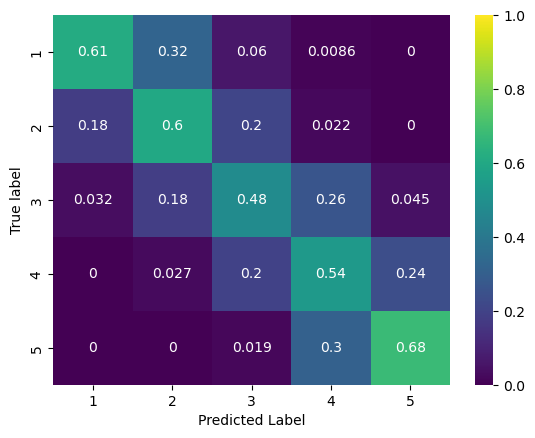

In [21]:
show_metrics("stella_en_1.5B_v5_20240807_231658_2", data_type="validation")

/opt/miniconda3/envs/erdos_company_discourse/lib/python3.11/site-packages/torch/nn/modules/lazy.py:180: UserWarning: Lazy modules are a new feature under heavy development so changes to the API or functionality can happen at any moment.
  warnings.warn('Lazy modules are a new feature under heavy development '



Accuracy on test: 	0.580995


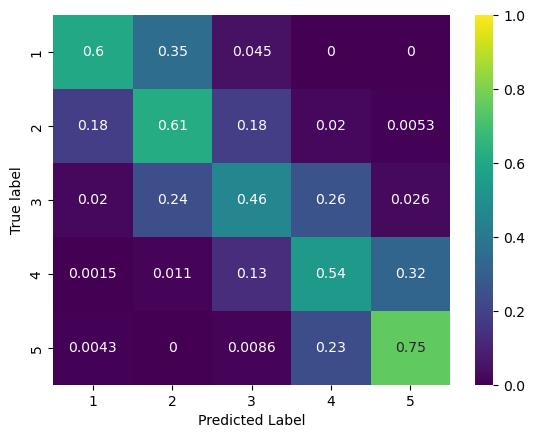

In [22]:
show_metrics("stella_en_1.5B_v5_20240807_231658_2", data_type="test")